## 1. Imports & Setup

In [1]:
# Basic libraries
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Add your src directory to sys.path if needed
import sys
sys.path.append("../src")  # or "./src" as per your notebook location

## 2. Data Preprocessing 


In [12]:
from dicom_preprocessing import DICOMPreprocessor
import os, numpy as np, SimpleITK as sitk

raw_dir = r"C:\Users\Harsh\lung_cancer_detection\data\raw"
processed_dir = r"C:\Users\Harsh\lung_cancer_detection\data\processed"
annotations_csv = r"C:\Users\Harsh\lung_cancer_detection\data\annotations\annotations.csv"

pre = DICOMPreprocessor(raw_dir, processed_dir)
images_dir = os.path.join(processed_dir, "images")

for img_file in os.listdir(images_dir):
    series_uid = img_file.replace(".npy", "")
    img_path = os.path.join(images_dir, img_file)
    img = np.load(img_path)

    # Convert normalized [0,1] image back to HU approx range
    hu_img = img * 1400 - 1000

    mask = pre.generate_lung_mask(hu_img)
    np.save(os.path.join(processed_dir, "masks", f"{series_uid}_mask.npy"), mask)


## 3. Visualize Preprocessed Data

In [13]:
import numpy as np, os

masks_dir = r"C:\Users\Harsh\lung_cancer_detection\data\processed\masks"
non_empty = 0

for mask_file in os.listdir(masks_dir):
    mask = np.load(os.path.join(masks_dir, mask_file))
    if np.max(mask) > 0:
        non_empty += 1

print(f"✅ Non-empty masks: {non_empty}/{len(os.listdir(masks_dir))}")


✅ Non-empty masks: 89/89


Found 89 images and 89 masks


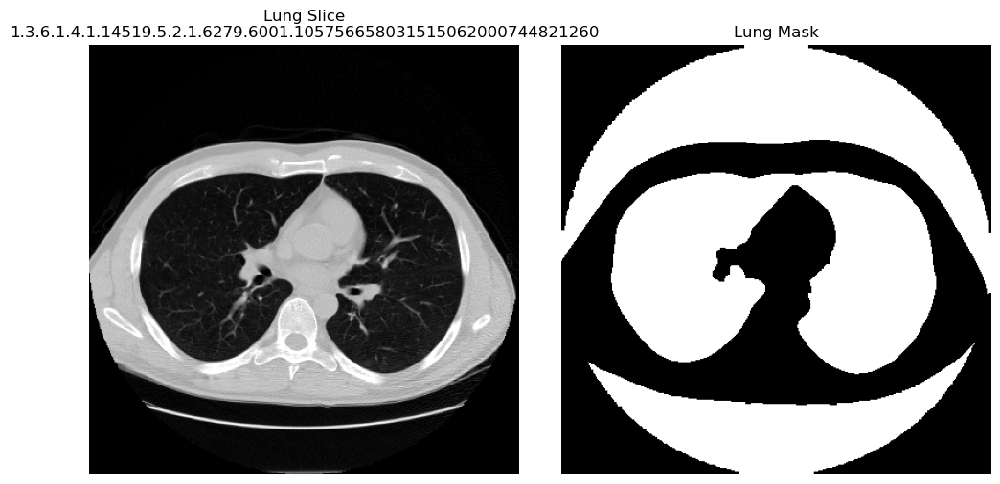

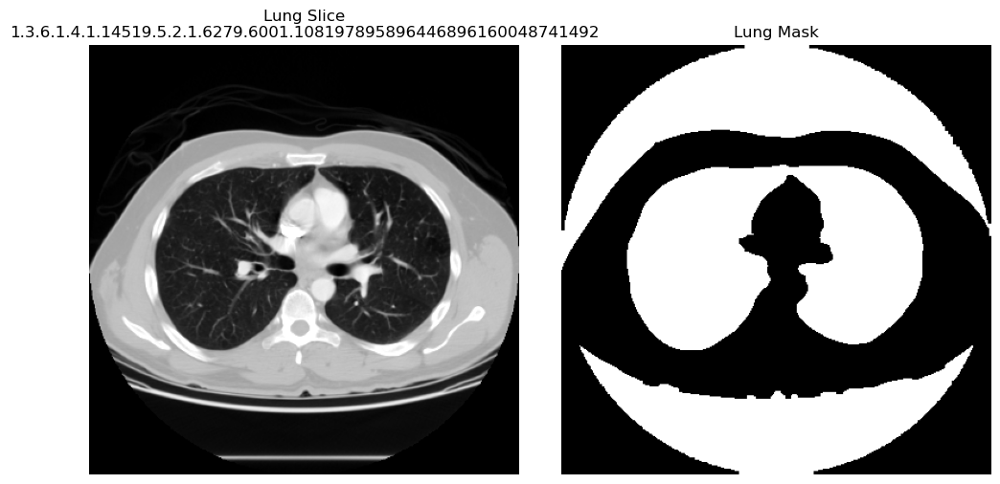

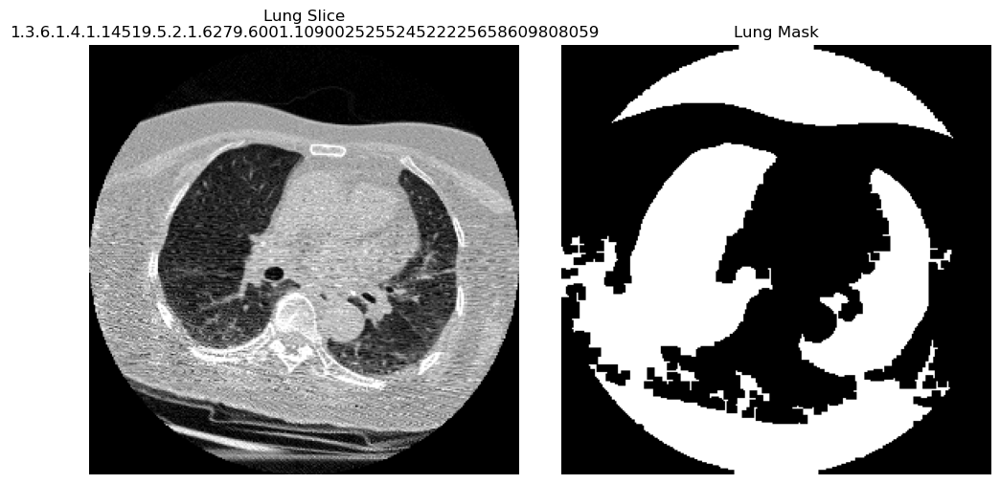

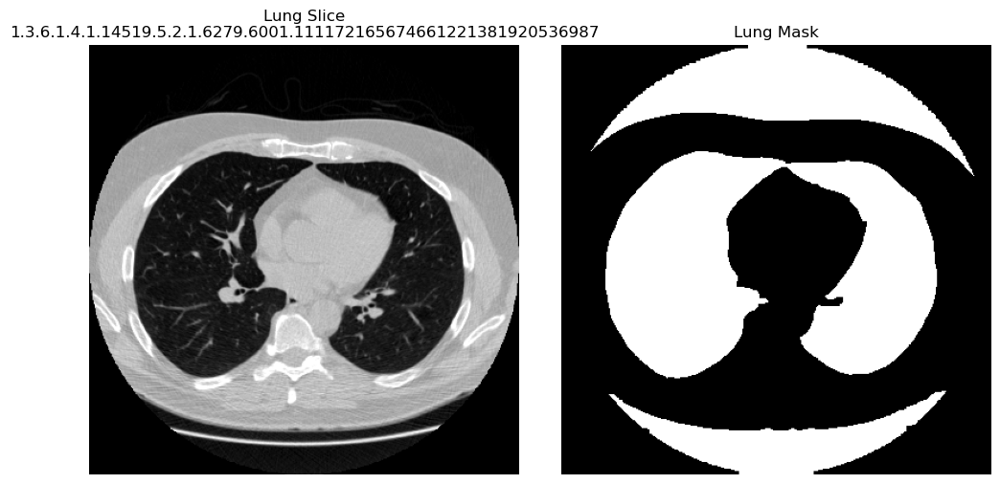

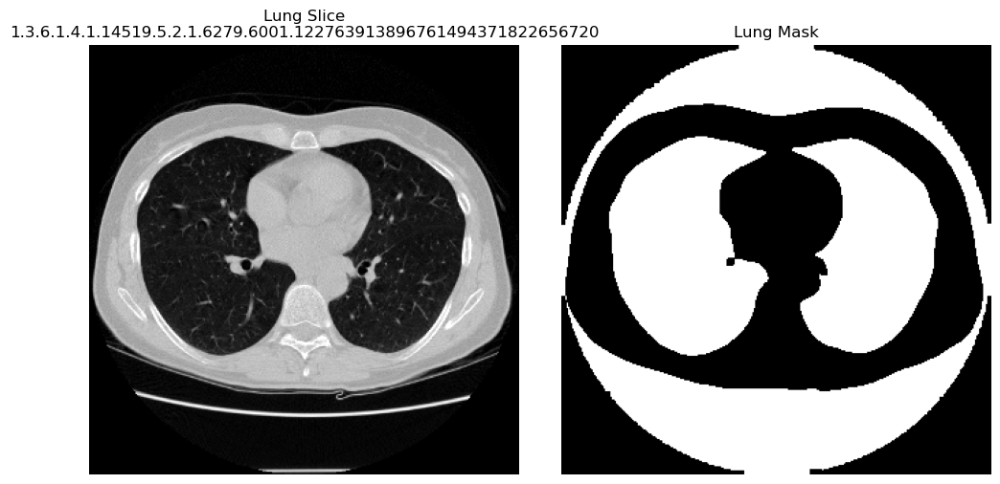

...

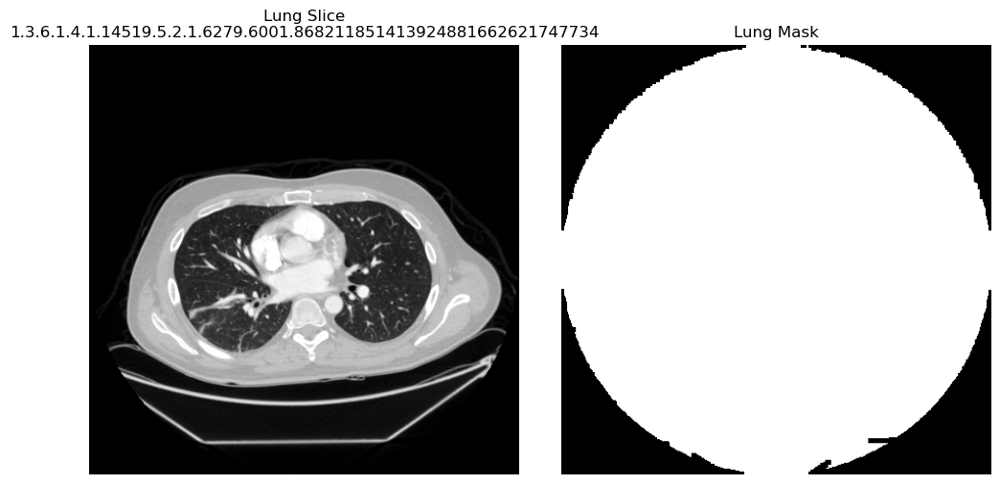

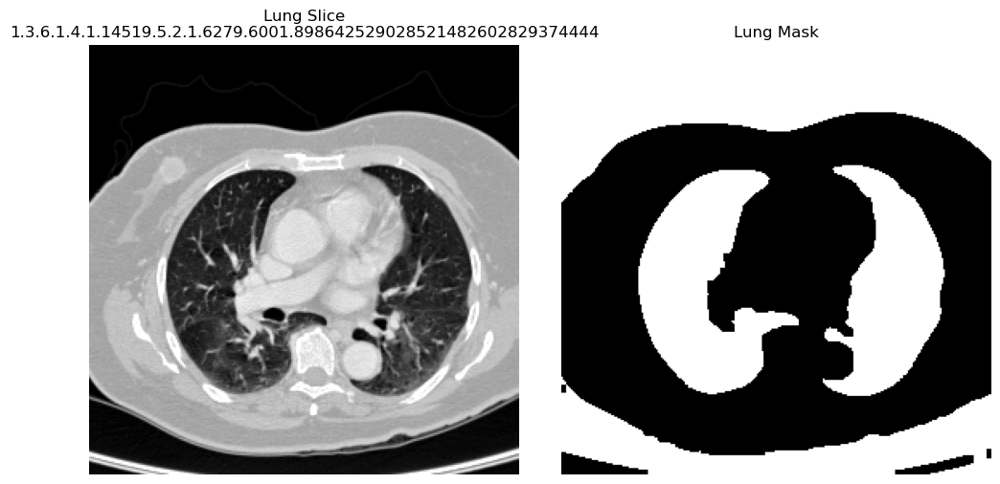

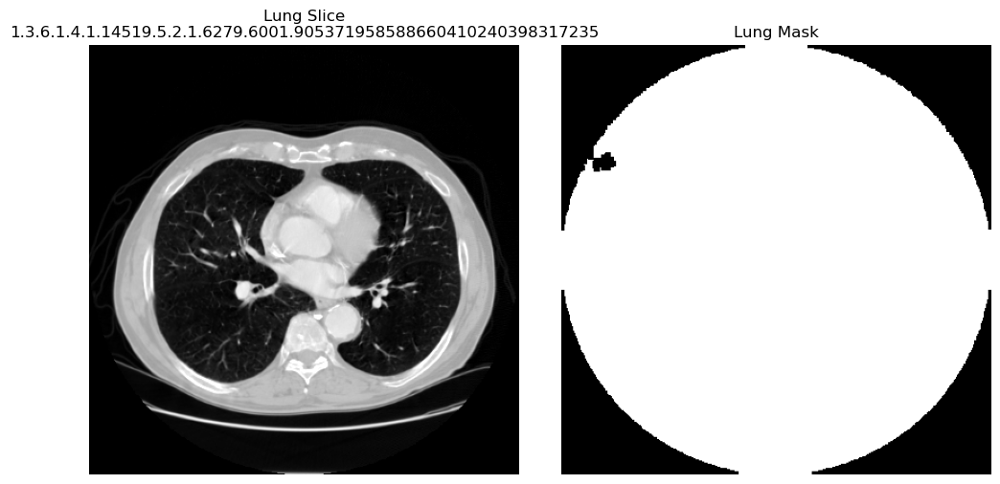

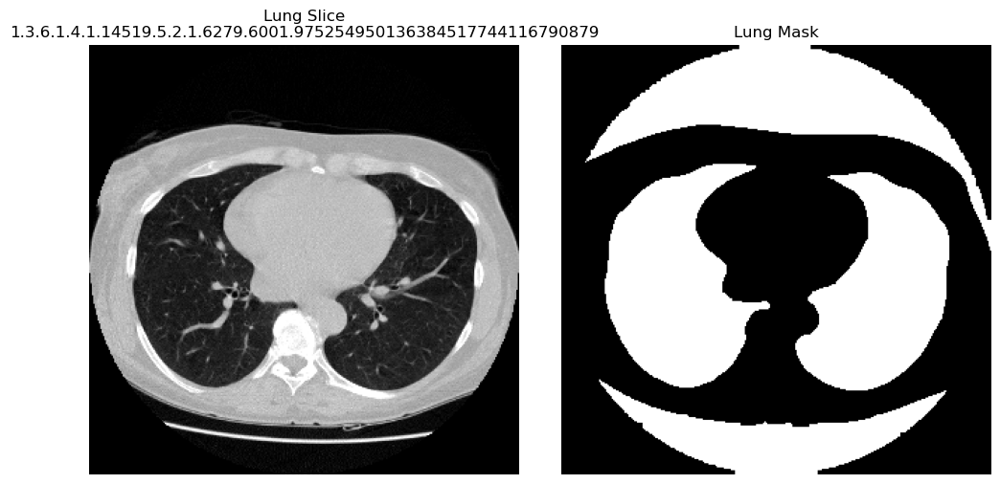

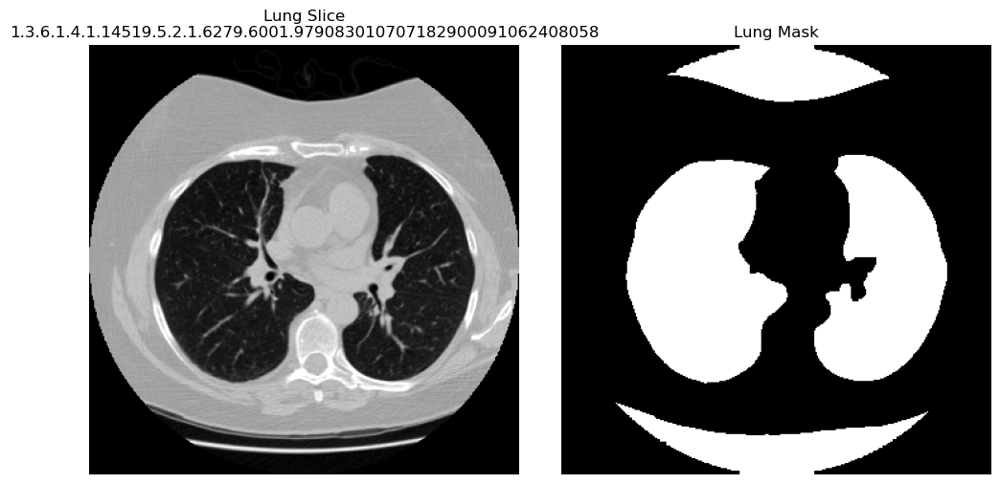

In [14]:
import os
import numpy as np
import matplotlib.pyplot as plt

# === Paths ===
processed_dir = r"C:\Users\Harsh\lung_cancer_detection\data\processed"
images_dir = os.path.join(processed_dir, "images")
masks_dir = os.path.join(processed_dir, "masks")

# === File Lists ===
image_files = sorted(os.listdir(images_dir))
mask_files = sorted(os.listdir(masks_dir))
print(f"Found {len(image_files)} images and {len(mask_files)} masks")

# === Display Function ===
def show_image_and_mask(img, mask, name):
    plt.figure(figsize=(10,5))
    plt.subplot(1,2,1)
    plt.imshow(img, cmap='gray')
    plt.title(f"Lung Slice\n{name}")
    plt.axis('off')

    plt.subplot(1,2,2)
    plt.imshow(mask, cmap='gray')
    plt.title("Lung Mask")
    plt.axis('off')

    plt.tight_layout()
    plt.show()

# === Loop Through All ===
for img_name in image_files:
    img_path = os.path.join(images_dir, img_name)
    series_uid = img_name.replace('.npy', '')
    mask_name = f"{series_uid}_mask.npy"
    mask_path = os.path.join(masks_dir, mask_name)

    if not os.path.exists(mask_path):
        print(f"⚠️ No mask found for {img_name}, skipping.")
        continue

    img = np.load(img_path)
    mask = np.load(mask_path)

    if img.ndim == 3:
        mid = img.shape[0] // 2
        img = img[mid]
        mask = mask[mid]

    # Skip if mask is empty
    if np.max(mask) == 0:
        print(f"⚠️ Empty mask for {img_name}, skipping.")
        continue

    show_image_and_mask(img, mask, series_uid)


## 4. Train Lung Segmentation Model

In [16]:
import os
import shutil
from sklearn.model_selection import train_test_split

# === Directory setup ===
processed_dir = r"C:\Users\Harsh\lung_cancer_detection\data\processed"
image_dir = os.path.join(processed_dir, "images")
mask_dir = os.path.join(processed_dir, "masks")

# === Gather all image-mask pairs ===
all_images = [f for f in os.listdir(image_dir) if f.endswith(".npy")]
all_masks = [f for f in os.listdir(mask_dir) if f.endswith("_mask.npy")]

# Extract UIDs from masks to ensure only valid pairs
mask_basenames = [f.replace("_mask.npy", "") for f in all_masks]
image_basenames = [os.path.splitext(f)[0] for f in all_images if os.path.splitext(f)[0] in mask_basenames]

print(f"Found {len(image_basenames)} valid image–mask pairs")

# === Split dataset ===
train_ids, val_ids = train_test_split(image_basenames, test_size=0.2, random_state=42)

def copy_files(ids, split):
    for uid in ids:
        img_src = os.path.join(image_dir, f"{uid}.npy")
        mask_src = os.path.join(mask_dir, f"{uid}_mask.npy")

        img_dst_dir = os.path.join(processed_dir, split, "images")
        mask_dst_dir = os.path.join(processed_dir, split, "masks")

        os.makedirs(img_dst_dir, exist_ok=True)
        os.makedirs(mask_dst_dir, exist_ok=True)

        img_dst = os.path.join(img_dst_dir, f"{uid}.npy")
        mask_dst = os.path.join(mask_dst_dir, f"{uid}_mask.npy")

        try:
            shutil.copy(img_src, img_dst)
            shutil.copy(mask_src, mask_dst)
        except FileNotFoundError:
            print(f"⚠️ Missing file for {uid}, skipping.")
            continue

# === Copy train/val splits ===
copy_files(train_ids, "train")
copy_files(val_ids, "val")

print(f"✅ Data split completed: {len(train_ids)} train, {len(val_ids)} val samples")


Found 89 valid image–mask pairs
✅ Data split completed: 71 train, 18 val samples


In [17]:
from unet_3d_lung_segmentation import UNet3D, train_lung_segmentation, LungSegmentationDataset
import torch
from torch.utils.data import DataLoader
import os

processed_dir = r"C:\Users\Harsh\lung_cancer_detection\data\processed"

train_dataset = LungSegmentationDataset(processed_dir, split='train')
val_dataset = LungSegmentationDataset(processed_dir, split='val')

# RTX 4050/4060 can handle batch size 2–4 comfortably
train_loader = DataLoader(train_dataset, batch_size=2, shuffle=True, num_workers=2)
val_loader = DataLoader(val_dataset, batch_size=2, shuffle=False, num_workers=2)

model = UNet3D(n_channels=1, n_classes=1)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"✅ Using device: {device}")

train_lung_segmentation(model, train_loader, val_loader, num_epochs=2, device=device)


✅ Using device: cpu


C:\Users\Harsh\lung_cancer_detection\src\unet_3d_lung_segmentation.py:100: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()
C:\Users\Harsh\anaconda3\Lib\site-packages\torch\cuda\amp\grad_scaler.py:31: UserWarning: torch.cuda.amp.GradScaler is enabled, but CUDA is not available.  Disabling.
  super().__init__(
Epoch 1/10 [Train]:   0%|          | 0/36 [00:04<?, ?it/s]


RuntimeError: Caught RuntimeError in DataLoader worker process 0.
Original Traceback (most recent call last):
  File "C:\Users\Harsh\anaconda3\Lib\site-packages\torch\utils\data\_utils\worker.py", line 349, in _worker_loop
    data = fetcher.fetch(index)  # type: ignore[possibly-undefined]
  File "C:\Users\Harsh\anaconda3\Lib\site-packages\torch\utils\data\_utils\fetch.py", line 55, in fetch
    return self.collate_fn(data)
           ~~~~~~~~~~~~~~~^^^^^^
  File "C:\Users\Harsh\anaconda3\Lib\site-packages\torch\utils\data\_utils\collate.py", line 398, in default_collate
    return collate(batch, collate_fn_map=default_collate_fn_map)
  File "C:\Users\Harsh\anaconda3\Lib\site-packages\torch\utils\data\_utils\collate.py", line 212, in collate
    collate(samples, collate_fn_map=collate_fn_map)
    ~~~~~~~^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\Harsh\anaconda3\Lib\site-packages\torch\utils\data\_utils\collate.py", line 155, in collate
    return collate_fn_map[elem_type](batch, collate_fn_map=collate_fn_map)
           ~~~~~~~~~~~~~~~~~~~~~~~~~^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\Harsh\anaconda3\Lib\site-packages\torch\utils\data\_utils\collate.py", line 271, in collate_tensor_fn
    out = elem.new(storage).resize_(len(batch), *list(elem.size()))
RuntimeError: Trying to resize storage that is not resizable


In [18]:
from unet_3d_lung_segmentation import LungSegmentationDataset
ds = LungSegmentationDataset(r"C:\Users\Harsh\lung_cancer_detection\data\processed", split='train')
img, mask = ds[0]
print(img.shape, mask.shape)


torch.Size([1, 298, 380, 380]) torch.Size([1, 298, 380, 380])
